In [1]:
from pathlib import Path

import pandas as pd
from PIL import Image
from torchvision.transforms import InterpolationMode, v2
from tqdm import tqdm

from paths import DATA_DIR, METADATA_DIR

folder_metas = [("train", "SnakeCLEF2023-TrainMetadata-iNat.csv"),
                ("train", "SnakeCLEF2023-TrainMetadata-HM.csv"),
                ("val", "SnakeCLEF2023-ValMetadata.csv")]

new_metadata = pd.DataFrame()
missing_images = {metadata_file: [] for stage, metadata_file in folder_metas}
for folder, metadata_file in folder_metas:

    df = pd.read_csv(METADATA_DIR / metadata_file)
    img_paths = df['image_path']

    for img_path in tqdm(img_paths):
        if not (DATA_DIR / folder / img_path).exists():
            missing_images[metadata_file].append(img_path)
            
print(missing_images)

100%|██████████| 14117/14117 [00:00<00:00, 87247.30it/s]

{'SnakeCLEF2023-TrainMetadata-iNat.csv': [], 'SnakeCLEF2023-TrainMetadata-HM.csv': [], 'SnakeCLEF2023-ValMetadata.csv': []}


In [ ]:
images, labels = v2.CutMix()(images, labels)

In [5]:
train_df = pd.concat([pd.read_csv(METADATA_DIR / "SnakeCLEF2023-TrainMetadata-iNat.csv"),
                     pd.read_csv(METADATA_DIR / "SnakeCLEF2023-TrainMetadata-HM.csv")])

In [7]:
train_df.class_id.value_counts().describe()

count    1784.000000
mean       94.017377
std       131.663728
min         3.000000
25%        19.000000
50%        55.000000
75%       122.000000
max      1891.000000
Name: count, dtype: float64

       observation_id  endemic            binomial_name code  \
1027         98349309    False  Acanthophis antarcticus   AU   
3135          6560637    False  Acanthophis antarcticus   AU   
5346         25506066    False  Acanthophis antarcticus   AU   
5347         25506066    False  Acanthophis antarcticus   AU   
5915         16062117    False  Acanthophis antarcticus   AU   
...               ...      ...                      ...  ...   
147018      141777003    False  Acanthophis antarcticus   AU   
151903      145821484    False  Acanthophis antarcticus   AU   
151904      145821484    False  Acanthophis antarcticus   AU   
13308        HM 38952    False  Acanthophis antarcticus   AU   
13309        HM 52973    False  Acanthophis antarcticus   AU   

                                         image_path  class_id    subset  
1027    2004/Acanthophis_antarcticus/163722425.jpeg         0     train  
3135       2008/Acanthophis_antarcticus/8320105.jpg         0     train  
5346     

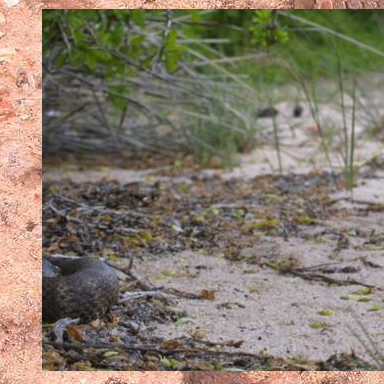

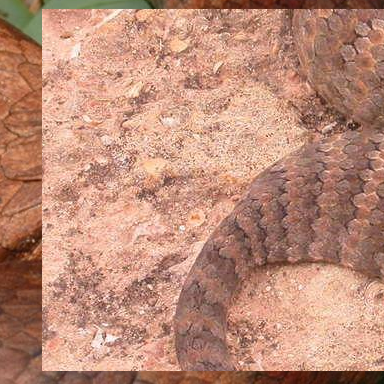

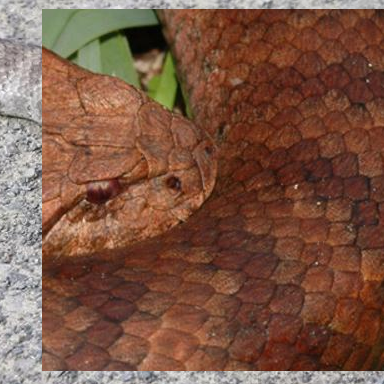

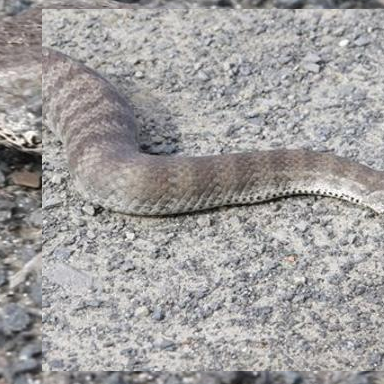

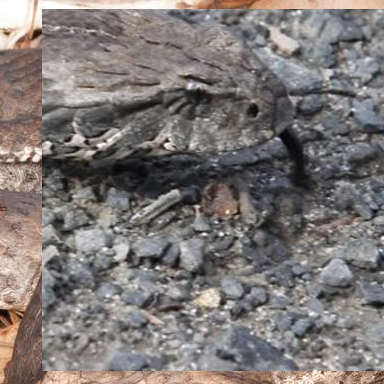

...

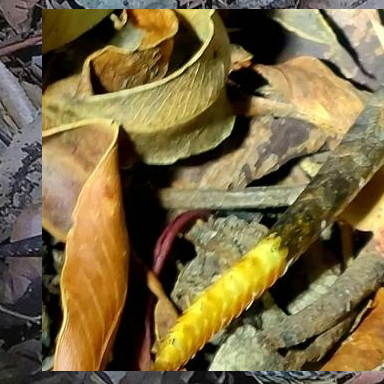

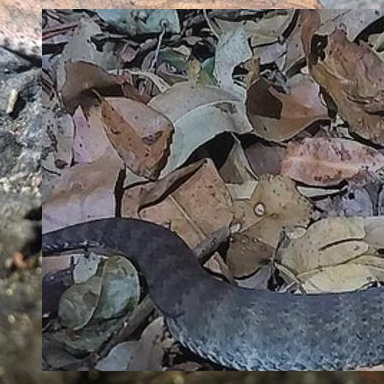

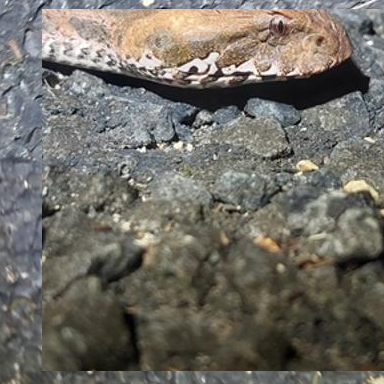

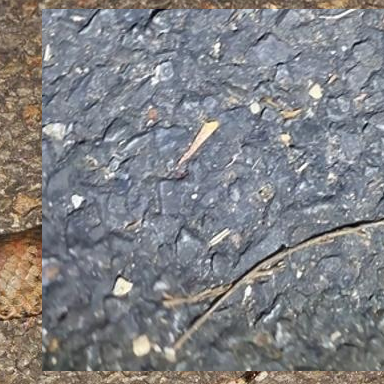

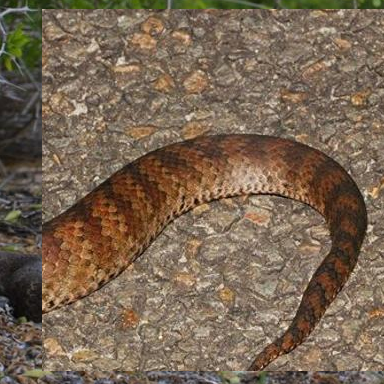

In [21]:
import torch

image_to_tensor = v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])

for cls, cls_df in train_df.groupby("class_id"):
    if len(cls_df) > 100:
        continue

    images = []
    for img_path in cls_df["image_path"]:
        with open(DATA_DIR / "train" / img_path, "rb") as f:
            image = Image.open(f).convert('RGB')
            image = v2.RandomCrop(384)(image)
        image = image_to_tensor(image).unsqueeze(0)
        images.append(image)
    labels = torch.tensor([cls]*len(images))
    images = torch.cat(images)
    images, labels = v2.CutMix(num_classes=1784)(images, labels)
    print(cls_df)

    for i, img in enumerate(images):
        img = v2.ToPILImage()(img)
        img.show()
    
    break

In [22]:
import numpy as np
import torch
from torch.nn.functional import interpolate


@torch.no_grad()
def resizemix(img,
              gt_label,
              scope=(0.1, 0.8),
              dist_mode=False,
              alpha=1.0,
              lam=None,
              use_alpha=False,
              interpolate_mode="nearest",
              return_mask=False,
              **kwargs):
    r""" ResizeMix augmentation.

    "ResizeMix: Mixing Data with Preserved Object Information and True Labels
    (https://arxiv.org/abs/2012.11101)".
    
    Args:
        img (Tensor): Input images of shape (N, C, H, W).
            Typically these should be mean centered and std scaled.
        gt_label (Tensor): Ground-truth labels (one-hot).
        alpha (float): To sample Beta distribution.
        lam (float): The given mixing ratio. If lam is None, sample a lam
            from Beta distribution.
        use_alpha (bool): Whether to use alpha instead of scope. Notice
            that ResizeMix is designed for supervised learning, it uses
            Uniform discribution rather than Beta. But in SSL contrastive
            learning, it's better to use large alpha.
        interpolate_mode (str): Mode of resizing interpolation {'nearest',
            'bilinear'}. Defaults to 'nearest'.
        scope (float): Sample Uniform distribution to get tao.
        dist_mode (bool): Whether to do cross gpus index shuffling and
            return the mixup shuffle index, which support supervised
            and self-supervised methods.
        return_mask (bool): Whether to return the cutting-based mask of
            shape (N, 1, H, W). Defaults to False.
    """

    def rand_bbox_tao(size, tao, return_mask=False):
        """ generate random box by tao (scale) """
        W = size[2]
        H = size[3]
        cut_w = int(W * tao)
        cut_h = int(H * tao)

        # uniform
        cx = np.random.randint(W)
        cy = np.random.randint(H)

        bbx1 = np.clip(cx - cut_w // 2, 0, W)
        bby1 = np.clip(cy - cut_h // 2, 0, H)
        bbx2 = np.clip(cx + cut_w // 2, 0, W)
        bby2 = np.clip(cy + cut_h // 2, 0, H)

        if not return_mask:
            return bbx1, bby1, bbx2, bby2
        else:
            mask = torch.zeros((1, 1, W, H)).cuda()
            mask[:, :, bbx1:bbx2, bby1:bby2] = 1
            mask = mask.expand(size[0], 1, W, H)  # (N, 1, H, W)
            return bbx1, bby1, bbx2, bby2, mask

    assert len(scope) == 2

    # normal mixup process
    if not dist_mode:
        rand_index = torch.randperm(img.size(0))
        if len(img.size()) == 4:  # [N, C, H, W]
            img_resize = img.clone()
            img_resize = img_resize[rand_index]
        else:
            assert img.dim() == 5  # semi-supervised img [N, 2, C, H, W]
            # * notice that the rank of two groups of img is fixed
            img_resize = img[:, 1, ...].contiguous()
            img = img[:, 0, ...].contiguous()
        _, _, h, w = img.size()
        shuffled_gt = gt_label[rand_index]

        # generate tao
        if lam is None:
            if use_alpha == True:
                tao = np.random.beta(alpha, alpha)
                if tao < scope[0] or tao > scope[1]:
                    tao = np.random.uniform(scope[0], scope[1])
            else:
                # original settings in ResizeMix
                tao = np.random.uniform(scope[0], scope[1])
        else:
            tao = min(max(lam, scope[0]), scope[1])

        # random box
        if not return_mask:
            bbx1, bby1, bbx2, bby2 = rand_bbox_tao(img.size(), tao)
        else:
            bbx1, bby1, bbx2, bby2, mask = rand_bbox_tao(img.size(), tao, True)
        img_resize = interpolate(
            img_resize, (bby2 - bby1, bbx2 - bbx1), mode=interpolate_mode
        )

        img[:, :, bby1:bby2, bbx1:bbx2] = img_resize
        # adjust lambda to exactly match pixel ratio
        lam = 1 - ((bbx2 - bbx1) * (bby2 - bby1) / (w * h))
        if return_mask:
            img = (img, mask)

        return img, (gt_label, shuffled_gt, lam)

    # dist mixup with cross gpus shuffle
    else:
        if len(img.size()) == 5:  # self-supervised img [N, 2, C, H, W]
            img_ = img[:, 1, ...].contiguous()
            img = img[:, 0, ...].contiguous()
            img_, idx_shuffle, idx_unshuffle = batch_shuffle_ddp(  # N
                img_, idx_shuffle=kwargs.get("idx_shuffle_mix", None), no_repeat=True)
        else:
            assert len(img.size()) == 4  # normal img [N, C, H, w]
            img_, idx_shuffle, idx_unshuffle = batch_shuffle_ddp(  # N
                img, idx_shuffle=kwargs.get("idx_shuffle_mix", None), no_repeat=True)
        _, _, h, w = img.size()

        # generate tao
        if lam is None:
            if use_alpha == True:
                tao = np.random.beta(alpha, alpha)
                if tao < scope[0] or tao > scope[1]:
                    tao = np.random.uniform(scope[0], scope[1])
            else:
                # original settings in ResizeMix
                tao = np.random.uniform(scope[0], scope[1])
        else:
            tao = lam

        # random box
        if not return_mask:
            bbx1, bby1, bbx2, bby2 = rand_bbox_tao(img.size(), tao)
        else:
            bbx1, bby1, bbx2, bby2, mask = rand_bbox_tao(img.size(), tao, True)
        img_ = interpolate(img_, (bby2 - bby1, bbx2 - bbx1), mode=interpolate_mode)
        
        img[:, :, bby1:bby2, bbx1:bbx2] = img_
        # adjust lambda to exactly match pixel ratio
        lam = 1 - ((bbx2 - bbx1) * (bby2 - bby1) / (w * h))
        if return_mask:
            img = (img, mask)

        if gt_label is not None:
            y_a = gt_label
            y_b, _, _ = batch_shuffle_ddp(
                gt_label, idx_shuffle=idx_shuffle, no_repeat=True)
            return img, (y_a, y_b, lam)
        else:
            return img, (idx_shuffle, idx_unshuffle, lam)


@torch.no_grad()
def batch_shuffle_ddp(x, idx_shuffle=None, no_repeat=False):
    """Batch shuffle (no grad), for making use of BatchNorm.
        *** Only support DistributedDataParallel (DDP) model. ***
        return: x, idx_shuffle, idx_unshuffle.
        *** no repeat (09.23 update) ***
    
    Args:
        idx_shuffle: Given shuffle index if not None.
        no_repeat: The idx_shuffle does not have any repeat index as
            the original indice [i for i in range(N)]. It's used in
            mixup methods (self-supervisedion).
    """
    # gather from all gpus
    batch_size_this = x.shape[0]
    x_gather = concat_all_gather(x)
    batch_size_all = x_gather.shape[0]

    num_gpus = batch_size_all // batch_size_this

    # random shuffle index
    if idx_shuffle is None:
        # generate shuffle idx
        idx_shuffle = torch.randperm(batch_size_all).cuda()
        # each idx should not be the same as the original
        if bool(no_repeat) == True:
            idx_original = torch.tensor([i for i in range(batch_size_all)]).cuda()
            idx_repeat = False
            for i in range(20):  # try 20 times
                if (idx_original == idx_shuffle).any() == True:  # find repeat
                    idx_repeat = True
                    idx_shuffle = torch.randperm(batch_size_all).cuda()
                else:
                    idx_repeat = False
                    break
            # repeat hit: prob < 1.8e-4
            if idx_repeat == True:
                fail_to_shuffle = True
                idx_shuffle = idx_original.clone()
                for i in range(3):
                    # way 1: repeat prob < 1.5e-5
                    rand_ = torch.randperm(batch_size_all).cuda()
                    idx_parition = rand_ > torch.median(rand_)
                    idx_part_0 = idx_original[idx_parition == True]
                    idx_part_1 = idx_original[idx_parition != True]
                    if idx_part_0.shape[0] == idx_part_1.shape[0]:
                        idx_shuffle[idx_parition == True] = idx_part_1
                        idx_shuffle[idx_parition != True] = idx_part_0
                        if (idx_original == idx_shuffle).any() != True:  # no repeat
                            fail_to_shuffle = False
                            break
                # fail prob -> 0
                if fail_to_shuffle == True:
                    # way 2: repeat prob = 0, but too simple!
                    idx_shift = np.random.randint(1, batch_size_all-1)
                    idx_shuffle = torch.tensor(  # shift the original idx
                        [(i+idx_shift) % batch_size_all for i in range(batch_size_all)]).cuda()
    else:
        assert idx_shuffle.size(0) == batch_size_all, \
            "idx_shuffle={}, batchsize={}".format(idx_shuffle.size(0), batch_size_all)

    # broadcast to all gpus
    torch.distributed.broadcast(idx_shuffle, src=0)

    # index for restoring
    idx_unshuffle = torch.argsort(idx_shuffle)

    # shuffled index for this gpu
    gpu_idx = torch.distributed.get_rank()
    idx_this = idx_shuffle.view(num_gpus, -1)[gpu_idx]

    return x_gather[idx_this], idx_shuffle, idx_unshuffle

      observation_id  endemic          binomial_name code  \
12898        6171764    False  Adelphicos veraepacis   GT   
12899        6171766    False  Adelphicos veraepacis   GT   
72400       52966759    False  Adelphicos veraepacis   GT   

                                    image_path  class_id subset  
12898  2020/Adelphicos_veraepacis/84225802.jpg        18  train  
12899   2013/Adelphicos_veraepacis/7741789.jpg        18  train  
72400  2013/Adelphicos_veraepacis/7741806.jpeg        18  train  


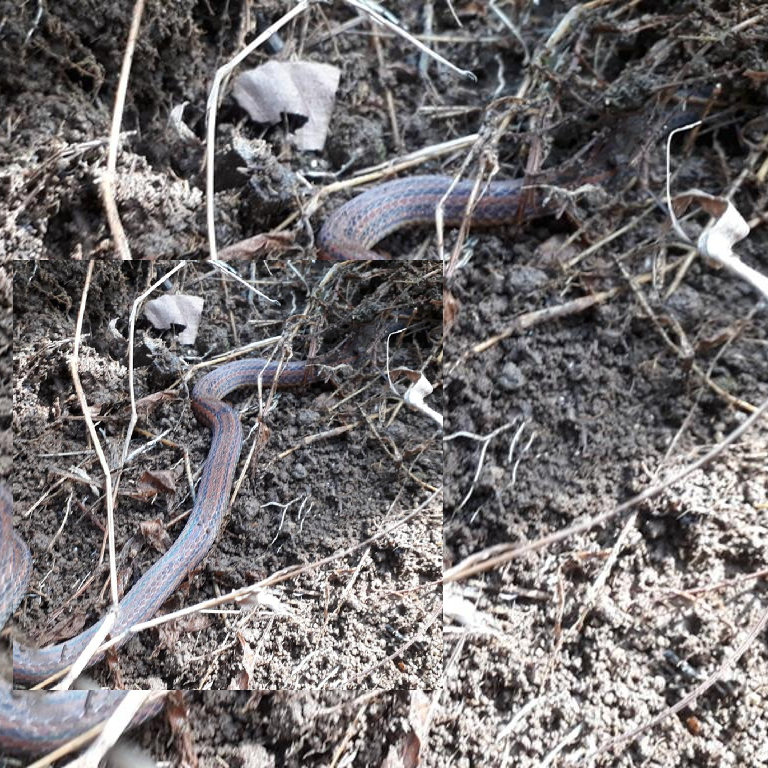

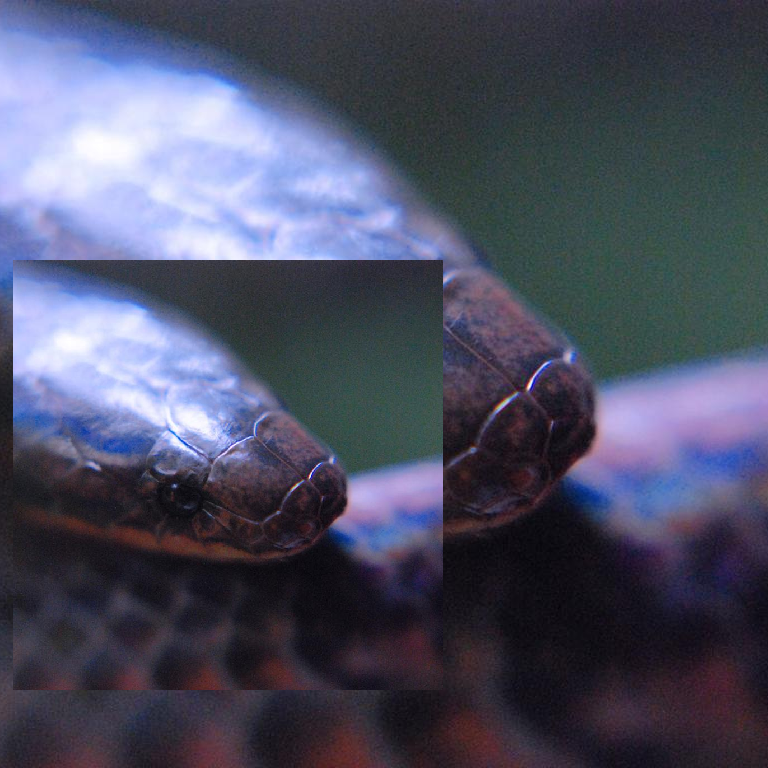

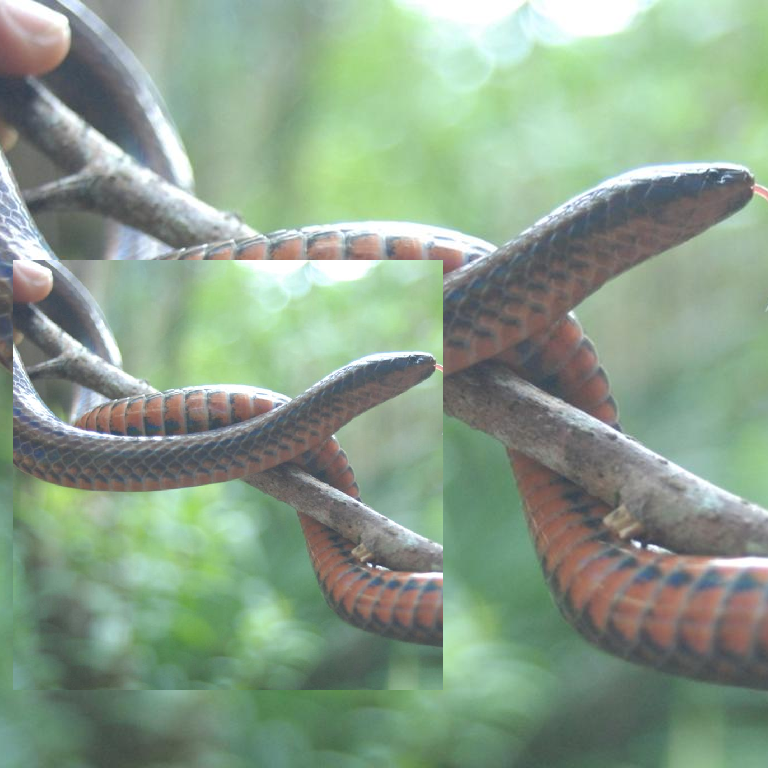

In [35]:
import torch
import torch.nn as nn
from focal_loss import FocalLoss
from torch.nn.functional import cross_entropy, one_hot, softmax

VENOMOUS_CLASS_IDS = torch.Tensor([0, 1, 2, 3, 4, 5, 6, 27, 29, 30, 32, 33, 34, 110, 112, 113, 114, 150, 151, 152, 154,
                                   159, 160, 162, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217,
                                   218, 219, 221, 222, 223, 224, 225, 226, 228, 229, 232, 233, 234, 235, 236, 237, 238,
                                   240, 241, 242, 243, 244, 245, 247, 248, 249, 256, 257, 258, 259, 260, 261, 262, 279,
                                   280, 285, 301, 302, 307, 308, 309, 310, 402, 403, 405, 406, 407, 409, 410, 411, 412,
                                   413, 414, 415, 416, 417, 418, 419, 420, 421, 422, 423, 424, 425, 427, 428, 429, 430,
                                   431, 433, 434, 437, 439, 440, 442, 443, 462, 463, 464, 465, 470, 510, 511, 512, 513,
                                   562, 595, 596, 597, 598, 599, 600, 601, 739, 740, 741, 742, 743, 783, 804, 805, 806,
                                   828, 829, 830, 855, 856, 857, 858, 999, 1033, 1034, 1035, 1036, 1037, 1040, 1041,
                                   1042, 1044, 1046, 1048, 1049, 1050, 1052, 1053, 1056, 1057, 1059, 1060, 1061, 1063,
                                   1065, 1066, 1068, 1071, 1072, 1073, 1076, 1079, 1081, 1082, 1087, 1088, 1090, 1091,
                                   1093, 1094, 1106, 1107, 1108, 1109, 1110, 1112, 1113, 1114, 1115, 1116, 1117, 1118,
                                   1119, 1120, 1121, 1122, 1123, 1124, 1125, 1126, 1127, 1128, 1129, 1158, 1190, 1191,
                                   1192, 1229, 1230, 1312, 1313, 1314, 1315, 1316, 1317, 1318, 1319, 1327, 1328, 1329,
                                   1330, 1370, 1371, 1372, 1373, 1374, 1375, 1376, 1382, 1383, 1389, 1390, 1391, 1392,
                                   1393, 1395, 1396, 1452, 1528, 1529, 1530, 1650, 1651, 1652, 1653, 1662, 1663, 1665,
                                   1666, 1668, 1669, 1670, 1671, 1674, 1679, 1680, 1682, 1684, 1685, 1686, 1687, 1688,
                                   1689, 1703, 1713, 1714, 1734, 1735, 1736, 1737, 1739, 1740, 1741, 1742, 1743, 1744,
                                   1745, 1746, 1747, 1749]).int()


class SeesawLoss(torch.nn.Module):
    """
    Implementation of seesaw loss.
    Refers to `Seesaw Loss for Long-Tailed Instance Segmentation (CVPR 2021)
    <https://arxiv.org/abs/2008.10032>
    Args:
        num_classes (int): The number of classes.
                Default to 1000 for the ImageNet dataset.
        p (float): The ``p`` in the mitigation factor.
                Defaults to 0.8.
        q (float): The ``q`` in the compensation factor.
                Defaults to 2.0.
        eps (float): The min divisor to smooth the computation of compensation factor.
                Default to 1e-2.
    """

    def __init__(self, num_classes=1000,
                 p=0.8, q=2.0, eps=1e-2, device='cpu'):
        super().__init__()
        self.num_classes = num_classes
        self.p = p
        self.q = q
        self.eps = eps
        self.device = device

        # cumulative samples for each category
        self.register_buffer('accumulate',
                             torch.zeros(self.num_classes, dtype=torch.float))
        self.accumulate = self.accumulate.to(device)

    def forward(self, output, target):
        # accumulate the samples for each category
        for unique in target.unique():
            self.accumulate[unique] += (target == unique.item()).sum()

        onehot_target = one_hot(target, self.num_classes)
        seesaw_weights = output.new_ones(onehot_target.size())

        # mitigation factor
        if self.p > 0:
            matrix = self.accumulate[None, :].clamp(min=1) / self.accumulate[:, None].clamp(min=1)
            index = (matrix < 1.0).float()
            sample_weights = matrix.pow(self.p) * index + (1 - index)  # M_{ij}
            mitigation_factor = sample_weights[target.long(), :]
            seesaw_weights = seesaw_weights * mitigation_factor

        # compensation factor
        if self.q > 0:
            scores = softmax(output.detach(), dim=1)
            self_scores = scores[torch.arange(0, len(scores)).to(scores.device).long(), target.long()]
            score_matrix = scores / self_scores[:, None].clamp(min=self.eps)
            index = (score_matrix > 1.0).float()
            compensation_factor = score_matrix.pow(self.q) * index + (1 - index)
            seesaw_weights = seesaw_weights * compensation_factor

        output = output + (seesaw_weights.log() * (1 - onehot_target))

        return cross_entropy(output, target, weight=None, reduction='none').mean()


class SupConLoss(nn.Module):
    """
    https://github.com/HobbitLong/SupContrast/blob/master/losses.py
    Author: Yonglong Tian (yonglong@mit.edu)
    Date: May 07, 2020
    Supervised Contrastive Learning: https://arxiv.org/pdf/2004.11362.pdf.
    It also supports the unsupervised contrastive loss in SimCLR
    """

    def __init__(self, temperature=0.07, contrast_mode='all',
                 base_temperature=0.07):
        super(SupConLoss, self).__init__()
        self.temperature = temperature
        self.contrast_mode = contrast_mode
        self.base_temperature = base_temperature

    def forward(self, features, labels=None, mask=None):
        """Compute loss for model. If both `labels` and `mask` are None,
        it degenerates to SimCLR unsupervised loss:
        https://arxiv.org/pdf/2002.05709.pdf

        Args:
            features: hidden vector of shape [bsz, n_views, ...].
            labels: ground truth of shape [bsz].
            mask: contrastive mask of shape [bsz, bsz], mask_{i,j}=1 if sample j
                has the same class as sample i. Can be asymmetric.
        Returns:
            A loss scalar.
        """
        device = features.device

        if len(features.shape) < 3:
            raise ValueError('`features` needs to be [bsz, n_views, ...],'
                             'at least 3 dimensions are required')
        if len(features.shape) > 3:
            features = features.view(features.shape[0], features.shape[1], -1)

        batch_size = features.shape[0]
        if labels is not None and mask is not None:
            raise ValueError('Cannot define both `labels` and `mask`')
        elif labels is None and mask is None:
            mask = torch.eye(batch_size, dtype=torch.float32).to(device)
        elif labels is not None:
            labels = labels.contiguous().view(-1, 1)
            if labels.shape[0] != batch_size:
                raise ValueError('Num of labels does not match num of features')
            mask = torch.eq(labels, labels.T).float().to(device)
        else:
            mask = mask.float().to(device)

        contrast_count = features.shape[1]
        contrast_feature = torch.cat(torch.unbind(features, dim=1), dim=0)
        if self.contrast_mode == 'one':
            anchor_feature = features[:, 0]
            anchor_count = 1
        elif self.contrast_mode == 'all':
            anchor_feature = contrast_feature
            anchor_count = contrast_count
        else:
            raise ValueError('Unknown mode: {}'.format(self.contrast_mode))

        # compute logits
        anchor_dot_contrast = torch.div(
            torch.matmul(anchor_feature, contrast_feature.T),
            self.temperature)
        # for numerical stability
        logits_max, _ = torch.max(anchor_dot_contrast, dim=1, keepdim=True)
        logits = anchor_dot_contrast - logits_max.detach()

        # tile mask
        mask = mask.repeat(anchor_count, contrast_count)
        # mask-out self-contrast cases
        logits_mask = torch.scatter(
            torch.ones_like(mask),
            1,
            torch.arange(batch_size * anchor_count).view(-1, 1).to(device),
            0
        )
        mask = mask * logits_mask

        # compute log_prob
        exp_logits = torch.exp(logits) * logits_mask
        log_prob = logits - torch.log(exp_logits.sum(1, keepdim=True))

        # compute mean of log-likelihood over positive
        # modified to handle edge cases when there is no positive pair
        # for an anchor point.
        # Edge case e.g.:-
        # features of shape: [4,1,...]
        # labels:            [0,1,1,2]
        # loss before mean:  [nan, ..., ..., nan]
        mask_pos_pairs = mask.sum(1)
        mask_pos_pairs = torch.where(mask_pos_pairs < 1e-6, 1, mask_pos_pairs)
        mean_log_prob_pos = (mask * log_prob).sum(1) / mask_pos_pairs

        # loss
        loss = - (self.temperature / self.base_temperature) * mean_log_prob_pos
        loss = loss.view(anchor_count, batch_size).mean()

        return loss


class CompositeLoss(torch.nn.Module):

    def __init__(self, multiclass_loss, use_venom_loss=True, venomous_class_ids=VENOMOUS_CLASS_IDS, use_logitnorm=True,
                 logitnorm_t=0.01,  # default set according to CIFAR-100 from https://arxiv.org/pdf/2205.09310
                 poison_loss_weight=1.,
                class_weights=None):
        super().__init__()
        self.multiclass_loss = multiclass_loss
        self.softmax = nn.Softmax(dim=-1)
        self.use_venom_loss = use_venom_loss
        self.venomous_class_ids = venomous_class_ids
        self.use_logitnorm = use_logitnorm
        self.logitnorm_t = logitnorm_t
        self.poison_loss_weight = poison_loss_weight
        self.class_weights = class_weights

    def forward(self, outputs, labels):
        if self.use_logitnorm:
            norms = torch.norm(outputs, p=2, dim=-1, keepdim=True) + 1e-7
            outputs = torch.div(outputs, norms) / self.logitnorm_t
        if isinstance(self.multiclass_loss, FocalLoss):
            loss = self.multiclass_loss(self.softmax(outputs), labels)
        else:
            loss = self.multiclass_loss(outputs, labels)

        if self.use_venom_loss:
            self.venomous_class_ids = self.venomous_class_ids.to(labels.device)
            n_classes = outputs.shape[1]

            # 0 for correct classification
            # 1 for non-venomous predicted as non-venomous
            # 2 for non-venomous predicted as venomous
            # 2 for venomous predicted as venomous
            # 5 for venomous predicted as non-venomous

            # make a cost matrix for all classes according to the above rules and the venomous class ids

            # use the cost matrix to calculate the loss
            # if class in poisonous_class_ids, then it's venomous
            cost_matrix = torch.ones((n_classes, n_classes)).to(labels.device)
            # each row represents the real class, each column represents the predicted class
            cost_matrix[self.venomous_class_ids, :] = 5
            cost_matrix[:, self.venomous_class_ids] = 2
            # fill diagonal with 0
            cost_matrix[torch.arange(n_classes), torch.arange(n_classes)] = 0
            # debugging: real, pred # venomous ex: 741, 857 # nonvenomous ex: 10, 25
            # assert (cost_matrix[741, 857] == 2 and
            #         cost_matrix[741, 10] == 5 and
            #         cost_matrix[10, 25] == 1 and
            #         cost_matrix[10, 10] == 0 and
            #         cost_matrix[10, 857] == 2)

            sm_outs = self.softmax(outputs)
            costs = cost_matrix[labels, :]
            if self.class_weights is not None:
                self.class_labels = self.class_labels.to(labels.device)
                costs = costs * self.class_weights[labels]
            # venom_loss = (costs * sm_outs.float()).sum(axis=-1).mean()
            venom_loss = (costs * -torch.log(sm_outs.float())).sum(axis=-1).mean()

            total_loss = loss + self.poison_loss_weight * venom_loss
            return total_loss

        return loss

    @staticmethod
    def split_open_closed(outputs, labels):
        """
        get the open and closed labels and outputs from the labels and outputs to calculate losses separately
        """
        closed_indices = labels >= 0
        open_indices = labels == -1
        n_closed = closed_indices.sum()
        n_open = open_indices.sum()
        closed_labels = labels[closed_indices]
        open_labels = labels[open_indices]
        closed_outputs = outputs[closed_indices]
        open_outputs = outputs[open_indices]
        return open_outputs, closed_outputs, open_labels, closed_labels, n_open, n_closed
